In [1]:
# Importing Libraries  
import geopandas as gpd
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd
import plotly.express as px 
import plotly.graph_objects as go  
from plotly.subplots import make_subplots
import plotly.offline as py 
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, BaggingRegressor  
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import cross_val_score, KFold, train_test_split 
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

sns.set_style('darkgrid')
plt.style.use('dark_background')

In [2]:
df = pd.read_csv("yieldmix.csv")
df.head()

,Unnamed: 0,Area,Item,Year,hg/ha_yield,average_rain_fall_mm_per_year,pesticides_tonnes,avg_temp
0,0,Albania,Maize,1990,36613,1485.0,121.0,16.37
1,1,Albania,Potatoes,1990,66667,1485.0,121.0,16.37
2,2,Albania,"Rice, paddy",1990,23333,1485.0,121.0,16.37
3,3,Albania,Sorghum,1990,12500,1485.0,121.0,16.37
4,4,Albania,Soybeans,1990,7000,1485.0,121.0,16.37


In [3]:
df.tail()

,Unnamed: 0,Area,Item,Year,hg/ha_yield,average_rain_fall_mm_per_year,pesticides_tonnes,avg_temp
28237,28237,Zimbabwe,"Rice, paddy",2013,22581,657.0,2550.07,19.76
28238,28238,Zimbabwe,Sorghum,2013,3066,657.0,2550.07,19.76
28239,28239,Zimbabwe,Soybeans,2013,13142,657.0,2550.07,19.76
28240,28240,Zimbabwe,Sweet potatoes,2013,22222,657.0,2550.07,19.76
28241,28241,Zimbabwe,Wheat,2013,22888,657.0,2550.07,19.76


In [4]:
df.columns

Index(['Unnamed: 0', 'Area', 'Item', 'Year', 'hg/ha_yield',
       'average_rain_fall_mm_per_year', 'pesticides_tonnes', 'avg_temp'],
      dtype='object')

In [5]:
df.drop('Unnamed: 0', axis = 1, inplace = True)

In [6]:
df.rename(columns = {'Area' : 'Country'}, inplace = True)

In [7]:
df.describe()

,Year,hg/ha_yield,average_rain_fall_mm_per_year,pesticides_tonnes,avg_temp
count,28242.000000,28242.000000,28242.00000,28242.000000,28242.000000
mean,2001.544296,77053.332094,1149.05598,37076.909344,20.542627
std,7.051905,84956.612897,709.81215,59958.784665,6.312051
min,1990.000000,50.000000,51.00000,0.040000,1.300000
25%,1995.000000,19919.250000,593.00000,1702.000000,16.702500
50%,2001.000000,38295.000000,1083.00000,17529.440000,21.510000
75%,2008.000000,104676.750000,1668.00000,48687.880000,26.000000
max,2013.000000,501412.000000,3240.00000,367778.000000,30.650000


In [8]:
df.dtypes

Country                           object
Item                              object
Year                               int64
hg/ha_yield                        int64
average_rain_fall_mm_per_year    float64
pesticides_tonnes                float64
avg_temp                         float64
dtype: object

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28242 entries, 0 to 28241
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Country                        28242 non-null  object 
 1   Item                           28242 non-null  object 
 2   Year                           28242 non-null  int64  
 3   hg/ha_yield                    28242 non-null  int64  
 4   average_rain_fall_mm_per_year  28242 non-null  float64
 5   pesticides_tonnes              28242 non-null  float64
 6   avg_temp                       28242 non-null  float64
dtypes: float64(3), int64(2), object(2)
memory usage: 1.5+ MB


In [10]:
df['Country'].value_counts()

Country
India         4048
Brazil        2277
Mexico        1472
Pakistan      1449
Japan          966
              ... 
Estonia         42
Belgium         39
Bahrain         29
Sudan           28
Montenegro      24
Name: count, Length: 101, dtype: int64

In [11]:
df['Country'].nunique()

101

In [12]:
df['Item'].value_counts()

Item
Potatoes                4276
Maize                   4121
Wheat                   3857
Rice, paddy             3388
Soybeans                3223
Sorghum                 3039
Sweet potatoes          2890
Cassava                 2045
Yams                     847
Plantains and others     556
Name: count, dtype: int64

In [13]:
df.describe(include = 'object')

,Country,Item
count,28242,28242
unique,101,10
top,India,Potatoes
freq,4048,4276


India is the most frequent country in the dataset while potatoes are the most frequent crop.

In [14]:
df['Year'].nunique()

23

In [15]:
df['Year'].value_counts()

Year
2012    1260
2013    1259
2011    1245
2010    1245
2008    1244
2006    1243
2009    1242
2007    1242
2005    1235
2004    1234
2000    1230
2001    1229
2002    1228
1998    1224
1997    1224
1999    1223
1993    1223
1996    1222
1995    1222
1994    1221
1992    1219
1991    1164
1990    1164
Name: count, dtype: int64

In [16]:
# Check for the countries with the highest overall crop yield  
df.groupby(['Country'], sort = True)[['hg/ha_yield']].sum().nlargest(10, 'hg/ha_yield')

,hg/ha_yield
Country,
India,327420324
Brazil,167550306
Mexico,130788528
Japan,124470912
Australia,109111062
Pakistan,73897434
Indonesia,69193506
United Kingdom,55419990
Turkey,52263950


In [17]:
# Check which specific crop yield is the highest respective to their country  
df.groupby(['Item','Country'], sort = True)['hg/ha_yield'].sum().nlargest(10)

Item            Country       
Cassava         India             142810624
Potatoes        India              92122514
                Brazil             49602168
                United Kingdom     46705145
                Australia          45670386
Sweet potatoes  India              44439538
Potatoes        Japan              42918726
                Mexico             42053880
Sweet potatoes  Mexico             35808592
                Australia          35550294
Name: hg/ha_yield, dtype: int64

The highest individual crop yield is Cassava from India. The highest individual crop yields are potatoes or sweet potatoes otherwise

In [18]:
# Check for the countries with the lowest overall crop yield  
df.groupby(['Country'], sort = True)[['hg/ha_yield']].sum().nsmallest(10, 'hg/ha_yield')

,hg/ha_yield
Country,
Botswana,470651
Eritrea,1452416
Montenegro,1645100
Sudan,1896346
Namibia,3165475
Estonia,3595638
Latvia,3698588
Tunisia,3724246
Nepal,4113713


In [19]:
# Check which specific crop yield is the lowest respective to their country  
df.groupby(['Item','Country'], sort = True)['hg/ha_yield'].sum().nsmallest(10)

Item      Country   
Soybeans  Malaysia       3333
          Tajikistan    18835
Sorghum   Albania       22914
          Sudan         23742
          Angola        38048
          Azerbaijan    39890
Maize     Botswana      54053
Soybeans  Angola        55062
Sorghum   Niger         59637
          Namibia       61740
Name: hg/ha_yield, dtype: int64

c:\Users\LENOVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



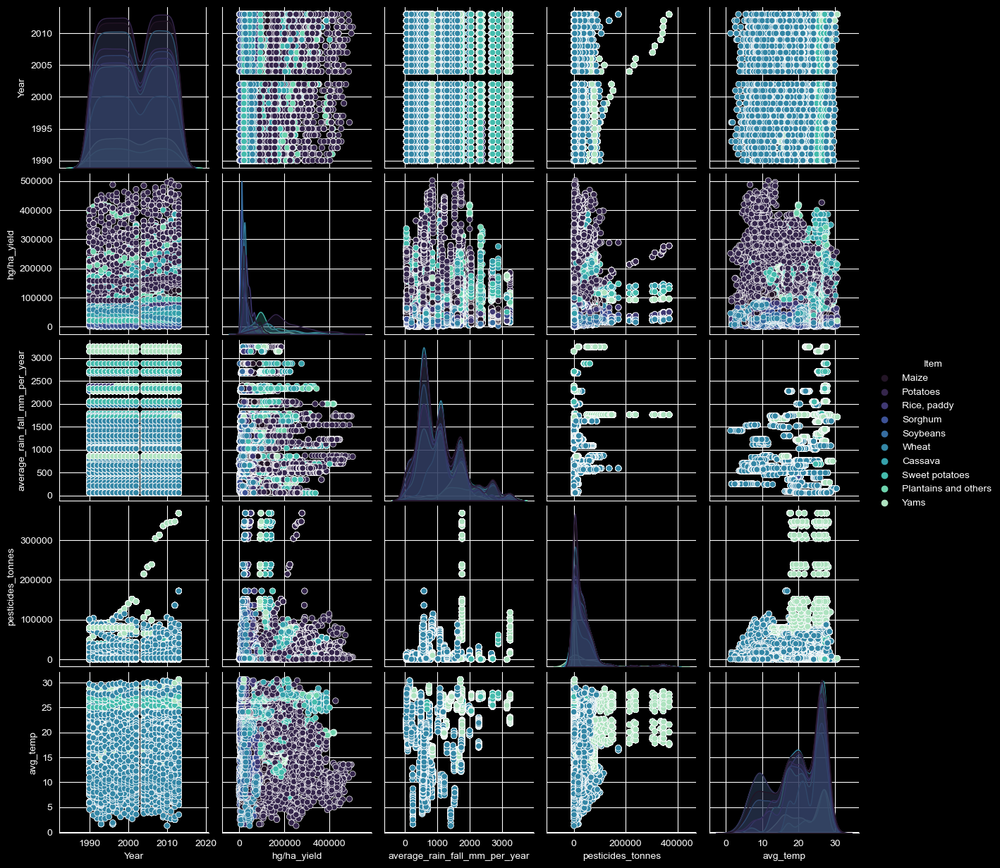

In [20]:
sns.pairplot(data = df, hue = 'Item', kind = 'scatter', palette = 'mako')

array([[<Axes: title={'center': 'Year'}>,
        <Axes: title={'center': 'hg/ha_yield'}>],
       [<Axes: title={'center': 'average_rain_fall_mm_per_year'}>,
        <Axes: title={'center': 'pesticides_tonnes'}>],
       [<Axes: title={'center': 'avg_temp'}>, <Axes: >]], dtype=object)

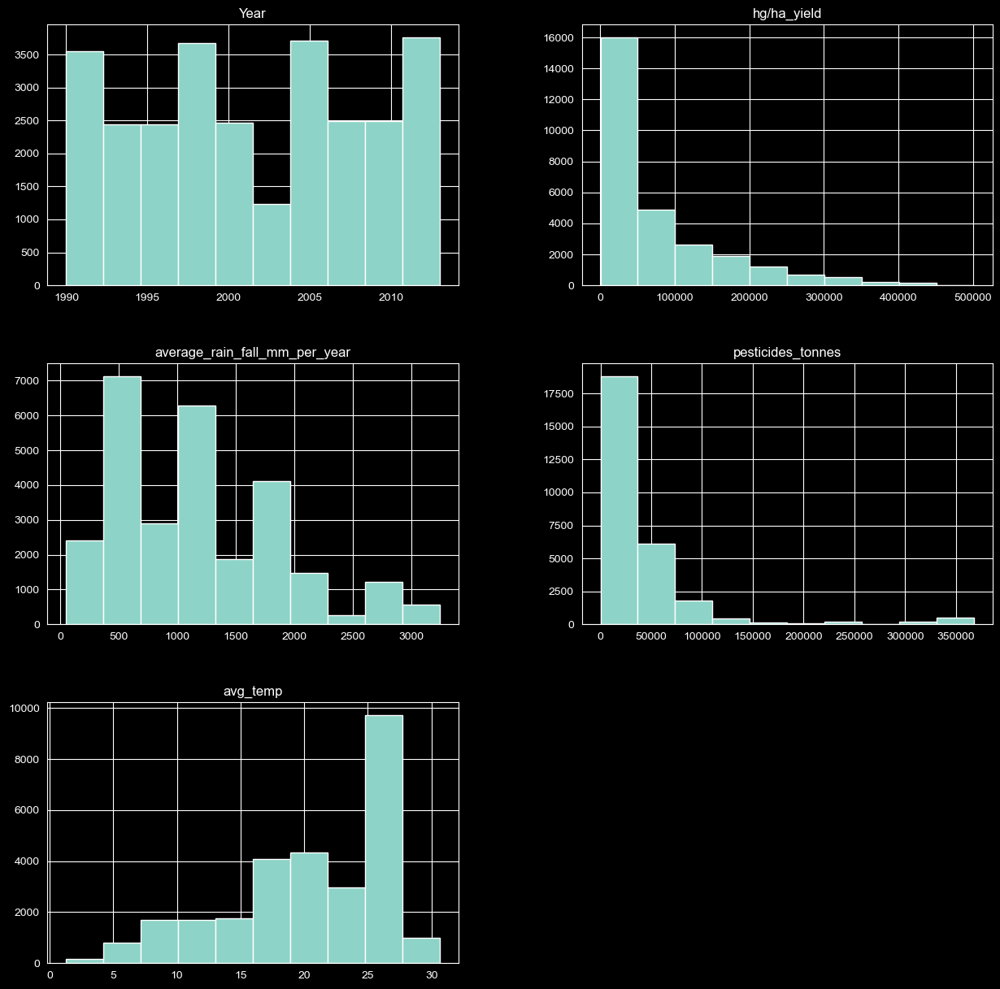

In [21]:
df.hist(figsize = (15, 15))

* Most rainfall is between 0 - 2000 mm.
* Most average temperatures around around 25 degrees celsius.
* Most crop yield is between 0 - 100000 hg / ha.
* Most pesticide use is between 0 - 50000 tons

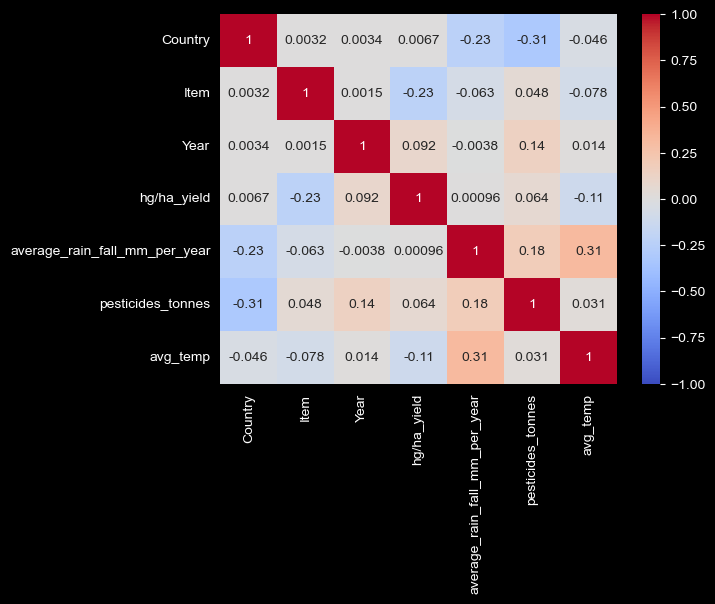

In [22]:
hm = df.copy()

cat_col = hm.select_dtypes(include = ['object']).columns.tolist()
label_encoder = LabelEncoder()

for col in cat_col :
    hm[col] = label_encoder.fit_transform(hm[col])

# Confusion Matrix 
cm = sns.heatmap(hm.corr(), annot = True, cmap='coolwarm', vmin=-1, vmax=1)
plt.show()

The strongest correlation is between country and pesticides_tonnes. The most likely explanation is that countries can have regulations on pesticides and countries use pesticides based on the prevalence of local pests.

In [23]:
px.scatter(df, x = 'hg/ha_yield', y = 'pesticides_tonnes', color = 'Country', template = 'plotly_dark') 

Pesticide use barely affects crop yield. The r value is 0.064 and the plot above displays this extremely weak correlation. For example, Brazil (the orange dots at the top of the plot), has a higher crop yield still being produced with roughly the same amount of pesticides

In [24]:
fig = px.box(df, x='Country', y='hg/ha_yield', color='Country', 
             labels={'hg/ha_yield': 'Crop Yield (hg/ha)', 'Country': 'Country'},
             template='plotly_dark', title='Crop Yield Distribution Across Countries')
fig.show()

In [25]:
fig = px.scatter(df, x='avg_temp', y='hg/ha_yield', color='Country',
                 labels={'avg_temp': 'Average Temperature (°C)', 'hg/ha_yield': 'Crop Yield (hg/ha)'},
                 title='Crop Yield vs. Average Temperature', template='plotly_dark')
fig.show()

In [26]:
fig = px.line(df, x='Year', y=['pesticides_tonnes', 'hg/ha_yield'], color='Country',
              labels={'value': 'Amount', 'Year': 'Year'},
              title='Pesticide Usage vs. Crop Yield Over Time', template='plotly_dark')
fig.show()

In [27]:
max_pesticide_usage = df.loc[df.groupby('Year')['pesticides_tonnes'].idxmax()]
min_pesticide_usage = df.loc[df.groupby('Year')['pesticides_tonnes'].idxmin()]

# Concatenate max and min pesticide usage data into one DataFrame
highest_lowest_df = pd.concat([max_pesticide_usage, min_pesticide_usage])

# Plotting the comparison of pesticide usage and crop yield over time
fig = px.line(highest_lowest_df, x='Year', y=['pesticides_tonnes', 'hg/ha_yield'], color='Country',
              labels={'value': 'Amount', 'Year': 'Year'},
              title='Highest and Lowest Pesticide Usage vs. Crop Yield Over Time')

fig.show()

In [28]:
fig = px.choropleth(df, locations='Country', locationmode='country names', color='hg/ha_yield',
                    hover_name='Country', title='Crop Yield by Country',
                    color_continuous_scale=px.colors.sequential.Viridis, template='plotly_dark')
fig.show()

In [29]:
fig = px.scatter(df, x='average_rain_fall_mm_per_year', y='hg/ha_yield', color='Item', 
                 labels={'average_rain_fall_mm_per_year': 'Average Rainfall (mm)', 'hg/ha_yield': 'Crop Yield (hg/ha)'},
                 title='Rainfall vs. Crop Yield', template='plotly_dark')
fig.show()

In [30]:
fig = px.box(df, x='Country', y='pesticides_tonnes', color='Country',
             labels={'pesticides_tonnes': 'Pesticides Used (tonnes)', 'Country': 'Country'},
             title='Pesticide Usage Distribution by Country', template='plotly_dark')
fig.show()

Brazil stands out as the largest pesticide user, with a staggering 367.778k tonnes, far exceeding Argentina's 171.94k tonnes and Colombia's 117.8815k tonnes. This significant usage is likely driven by Brazil's vast agricultural sector, particularly in crops like soy, sugarcane, and maize. While boosting crop yields, such heavy pesticide reliance raises environmental and health concerns, highlighting the need for more sustainable farming practices.

In [31]:
fig = px.scatter(df, x='avg_temp', y='average_rain_fall_mm_per_year', color='Item', 
                 labels={'avg_temp': 'Average Temperature (°C)', 'average_rain_fall_mm_per_year': 'Average Rainfall (mm)'},
                 title='Rainfall vs Temperature by Crop', template='plotly_dark')
fig.show()

wheat thrives in cooler climates with lower rainfall, while cassava and plantains prefer hotter, rainier conditions. The chart highlights how diverse crops like maize and rice can tolerate a wide range of temperatures and rainfall, making them versatile across various climates

In [32]:
# Method to display 4 interactive plots together vertically 
def four_subplots(plot1, plot2, plot3, plot4, w, h) : 
    figures = [plot1, plot2, plot3, plot4]
    fig = make_subplots(rows = len(figures), cols = 1, vertical_spacing = 0.05)
    
    for i, figure in enumerate(figures) :
        for trace in range(len(figure['data'])) :
            fig.append_trace(figure['data'][trace], row = i + 1, col = 1)
    
    fig.update_layout(width = w, height = h, template = 'plotly_dark')
            
    return fig  

In [33]:
fig1 = px.scatter(df, x = 'Item', y = 'hg/ha_yield', color = 'Country', template = 'plotly_dark') 
fig2 = px.scatter(df, x = 'Item', y = 'average_rain_fall_mm_per_year', color = 'Country', template = 'plotly_dark') 
fig3 = px.scatter(df, x = 'Item', y = 'pesticides_tonnes', color = 'Country', template = 'plotly_dark') 
fig4 = px.scatter(df, x = 'Item', y = 'avg_temp', color = 'Country', template = 'plotly_dark') 

fig = four_subplots(fig1, fig2, fig3, fig4, 1075, 2500)

# Changing axes labels   
fig.update_xaxes(title_text = 'Item', row = 1, col = 1)
fig.update_xaxes(title_text = 'Item', row = 2, col = 1)
fig.update_xaxes(title_text = 'Item', row = 3, col = 1)
fig.update_xaxes(title_text = 'Item', row = 4, col = 1)

fig.update_yaxes(title_text = 'hg/ha_yield', row = 1, col = 1)
fig.update_yaxes(title_text = 'average_rain_fall_mm_per_year', row = 2, col = 1)
fig.update_yaxes(title_text = 'pesticides_tonnes', row = 3, col = 1)
fig.update_yaxes(title_text = 'avg_temp', row = 4, col = 1)

fig.update_layout(showlegend = False) 

The top-producing crops are potatoes, cassava, and sweet potatoes.
Average amount of rainfall is more correlated towards country than crops.
Brazil uses the most pesticides by far out of any country.
Cassava, sweet potatoes, yams, and plantains & others grow in warmer climates while the rest of the crops grow in varying climates.

In [34]:
grouped = df.groupby('Item')

top_areas = []

# Create dataframe for the top individual crop yields  
for item, group in grouped :
    max_production_row = group[group['hg/ha_yield'] == group['hg/ha_yield'].max()]
    
    area = max_production_row['Country'].values[0]
    production = max_production_row['hg/ha_yield'].values[0]
    
    top_areas.append({'Item' : item, 'Country' : area, 'hg/ha_yield' : production})

top_areas_df = pd.DataFrame(top_areas)

top_areas_df

,Item,Country,hg/ha_yield
0,Cassava,India,385818
1,Maize,Qatar,207556
2,Plantains and others,Guatemala,418505
3,Potatoes,Belgium,501412
4,"Rice, paddy",Australia,103895
5,Sorghum,Algeria,206000
6,Soybeans,Turkey,41609
7,Sweet potatoes,Senegal,400000
8,Wheat,Zambia,99387
9,Yams,Mali,250000


In [35]:
px.bar(top_areas_df, x = 'hg/ha_yield', y = 'Country', color = 'Item', template = 'plotly_dark') 

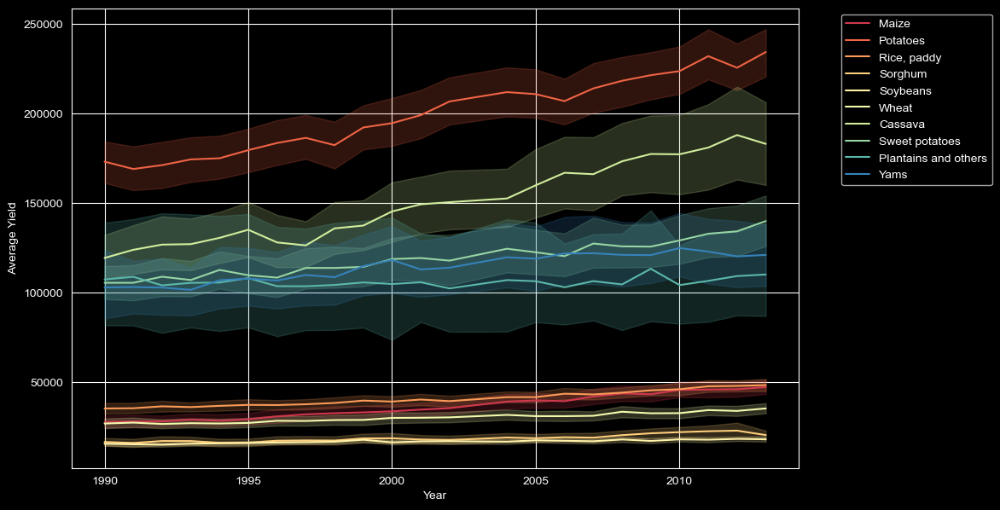

In [36]:
fig1 = px.scatter(df, x = 'pesticides_tonnes', y = 'hg/ha_yield', 
                  labels = {'pesticides_tonnes' : 'Pesticide Tons', 'hg/ha_yield' : 'Average Yield'}, 
                  color = 'Item', template = 'plotly_dark') 
fig2 = px.scatter(df, x = 'average_rain_fall_mm_per_year', y = 'hg/ha_yield', 
                  labels = {'average_rain_fall_mm_per_year' : 'Average Rainfall (mm) Per Year', 'hg/ha_yield' : 'Average Yield'}, 
                  color = 'Item', template = 'plotly_dark') 
fig3 = px.scatter(df, x = 'avg_temp', y = 'hg/ha_yield', 
                  labels = {'avg_temp' : 'Average Temperature', 'hg/ha_yield' : 'Average Yield'}, 
                  color = 'Item', template = 'plotly_dark') 
fig4 = sns.lineplot(x = 'Year', y = 'hg/ha_yield', hue = 'Item', data = df, legend = True, palette = 'Spectral')

fig1.show()
fig2.show()
fig3.show()

fig4.set(ylabel = 'Average Yield')
fig4.legend(bbox_to_anchor = (1.05, 1), loc = 'upper left')
plt.gcf().set_size_inches(11, 7) 
plt.style.use("dark_background") 
plt.show()

* Crop yield slightly decreases as pesticide usage increases.
* Crop yield slightly decreases as average rainfall increases after 2000 mm.
* Crop yield slightly decreases as the average temperature decreases before 5 Celsius.
* Crop yield has gradually increased over time.

In [37]:
fig1 = px.line(df.groupby(['Year'])['hg/ha_yield'].mean(), 
               labels = {'value' : 'hg/ha_yield'}, template = 'plotly_dark') 
fig1.show()

In [38]:
fig2 = px.line(df.groupby(['Year'])['average_rain_fall_mm_per_year'].mean(), 
               labels = {'value' : 'average_rain_fall_mm_per_year'}, template = 'plotly_dark') 
fig2.show()

In [39]:
fig3 = px.line(df.groupby(['Year'])['pesticides_tonnes'].mean(), 
               labels = {'value' : 'pesticides_tonnes'}, template = 'plotly_dark') 
fig3.show()

In [40]:
fig4 = px.line(df.groupby(['Year'])['avg_temp'].mean(), 
               labels = {'value' : 'avg_temp'}, template = 'plotly_dark') 
fig4.show()

* Crop yield has gradually increased over time.
* Average rainfall dropped significantly between 1990 - 1993 and has remained stable since then.
* Pesticide use has gradually increased over time.
* The average temperature has slightly increased over time.

In [41]:
X = df.drop(labels = 'hg/ha_yield', axis = 1)
y = df['hg/ha_yield']

# Convert data into dummy variables 
X = pd.get_dummies(X)

In [42]:
# Split the data into train and test sets 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

In [43]:
X_train.head()

,Year,average_rain_fall_mm_per_year,pesticides_tonnes,avg_temp,Country_Albania,Country_Algeria,Country_Angola,Country_Argentina,Country_Armenia,Country_Australia,...,Item_Cassava,Item_Maize,Item_Plantains and others,Item_Potatoes,"Item_Rice, paddy",Item_Sorghum,Item_Soybeans,Item_Sweet potatoes,Item_Wheat,Item_Yams
5493,2005,1604.0,829.59,25.36,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,False,False
10969,1992,1083.0,70791.00,25.91,False,False,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
2001,1997,1292.0,484.59,25.81,False,False,False,False,False,False,...,True,False,False,False,False,False,False,False,False,False
22157,1997,494.0,16936.00,23.76,False,False,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
311,2005,1010.0,40.00,24.41,False,False,True,False,False,False,...,False,False,False,False,False,False,False,True,False,False


In [44]:
results = []

# List of machine learning models that will be trained  
models = [
    ('Linear Regression', LinearRegression()),
    ('Decision Tree', DecisionTreeRegressor(random_state = 1)),
    ('Random Forest', RandomForestRegressor(random_state = 1)),
    ('Gradient Boost', GradientBoostingRegressor(n_estimators = 100, learning_rate = 0.1, max_depth = 3, random_state = 1)),
    ('XGBoost', XGBRegressor(random_state = 1)),
    ('Bagging Regressor', BaggingRegressor(n_estimators = 100, random_state = 1)),  
    ('KNN', KNeighborsRegressor(n_neighbors = 10))]

In [45]:
# Loops through the list of machine learning models above  
for name, model in models :
    # Train Model  
    model.fit(X_train, y_train)  
    # Make Predictions   
    y_pred = model.predict(X_test)                      
    
    accuracy = model.score(X_test, y_test)
    MSE = mean_squared_error(y_test, y_pred)
    R2_score = r2_score(y_test, y_pred)
    # Add all metrics of model to a list    
    results.append((name, accuracy, MSE, R2_score))     
    
    acc = (model.score(X_train , y_train) * 100)
    print(f'Accuracy of {name} Model Train is {acc:.2f}')
    acc = (model.score(X_test , y_test) * 100)
    print(f'Accuracy of the {name} Model Test is {acc:.2f}')  
    
    data = {'y_test' : [y_test], 
            'y_pred' : [y_pred]} 
    data_df = pd.DataFrame(data)
    
    fig = px.scatter(data_df, x = y_test, y = y_pred, 
                     labels = {'x' : 'Actual Values', 'y' : 'Predicted Values'},  
                     trendline = 'ols', trendline_color_override = 'red', 
                     template = 'plotly_dark')
    fig.show()

Accuracy of Linear Regression Model Train is 75.63
Accuracy of the Linear Regression Model Test is 75.51


Accuracy of Decision Tree Model Train is 100.00
Accuracy of the Decision Tree Model Test is 97.90


Accuracy of Random Forest Model Train is 99.83
Accuracy of the Random Forest Model Test is 98.75


Accuracy of Gradient Boost Model Train is 87.47
Accuracy of the Gradient Boost Model Test is 87.32


Accuracy of XGBoost Model Train is 98.34
Accuracy of the XGBoost Model Test is 97.59


Accuracy of Bagging Regressor Model Train is 99.83
Accuracy of the Bagging Regressor Model Test is 98.75


Accuracy of KNN Model Train is 45.80
Accuracy of the KNN Model Test is 33.20


In [46]:
# Dataframe consisting of metrics of all the models   
results_df = pd.DataFrame(results, columns = ['Model', 'Accuracy', 'MSE', 'R2_score'])
# Add red and green highlights in the dataframe to display best and worst performing models  
results_format_df = results_df.style.highlight_max(subset = ['Accuracy', 'R2_score'], color = 'green').highlight_min(subset = ['MSE'], color = 'green').highlight_max(subset = ['MSE'], color = 'red').highlight_min(subset = ['Accuracy','R2_score'], color = 'red')
display(results_format_df)

,Model,Accuracy,MSE,R2_score
0,Linear Regression,0.755142,1776116996.515923,0.755142
1,Decision Tree,0.979028,152126879.690211,0.979028
2,Random Forest,0.987491,90736304.678697,0.987491
3,Gradient Boost,0.873241,919466056.192313,0.873241
4,XGBoost,0.975929,174599934.341565,0.975929
5,Bagging Regressor,0.987528,90464333.251987,0.987528
6,KNN,0.332020,4845307069.320509,0.332020


The Bagging Regressor model was the most accurate with the Random Forest , Decision Tree, and XGBoost models extremely close behind. Out of the 7 models tested, these four models are by far the best models to utilize for predicting crop yield. The KNN model was by far the worst. The Linear Regression and Gradient Boost models had somewhat high accuracy, but not nearly as high as the aforementioned four models.

In [47]:
results = [] 
fold_df = pd.DataFrame()

# Loops through the list of machine learning models   
for name, model in models :
    # Train Model   
    model.fit(X_train, y_train)
    # Make Predictions     
    y_pred = model.predict(X_test)
    accuracy = model.score(X_test, y_test)
    MSE = mean_squared_error(y_test, y_pred)
    MAE = mean_absolute_error(y_test, y_pred)
    MAPE = mean_absolute_percentage_error(y_test, y_pred)
    R2_score = r2_score(y_test, y_pred)
    # Add all metrics of model to a list      
    results.append((name, accuracy, MSE, MAE, MAPE, R2_score))
    
    print(name)
    kf = KFold(n_splits = 10, shuffle = True)
    scores = cross_val_score(model, X, y, cv = kf)
    
    # Print out the CV Scores for each fold  
    for fold, score in enumerate(scores) :
        print(f'Fold {fold + 1}: {score}')
        temp_df = pd.DataFrame({'Name' : name, 'Fold' : [fold + 1], 'Score' : [score]}) 
        dfs = [fold_df, temp_df] 
        fold_df = pd.concat(dfs, ignore_index = True)

    # Print out the Mean CV scores for each model     
    mean_score = np.mean(scores)
    print(f'Mean Score: {mean_score}')
    print('=' * 30)

Linear Regression
Fold 1: 0.7463349255250074
Fold 2: 0.7605604197117395
Fold 3: 0.7494427096411458
Fold 4: 0.7623804476524212
Fold 5: 0.7540524139536745
Fold 6: 0.7499115852901717
Fold 7: 0.7478636297762344
Fold 8: 0.7526930846165387
Fold 9: 0.7496871785566842
Fold 10: 0.7637597764327352
Mean Score: 0.7536686171156353
Decision Tree
Fold 1: 0.9792190040113735
Fold 2: 0.9855965679171749
Fold 3: 0.9854843298399382
Fold 4: 0.9792882868791667
Fold 5: 0.980149079524219
Fold 6: 0.9838294134847563
Fold 7: 0.9798120376990271
Fold 8: 0.9833457765902671
Fold 9: 0.9829681246621201
Fold 10: 0.9840764771909303
Mean Score: 0.9823769097798973
Random Forest
Fold 1: 0.9907340723884589
Fold 2: 0.9886897901358428
Fold 3: 0.989482471460598
Fold 4: 0.9912735879433594
Fold 5: 0.9888394302463988
Fold 6: 0.9851274027457207
Fold 7: 0.9913892298052075
Fold 8: 0.9913998268974933
Fold 9: 0.9882285092131883
Fold 10: 0.9876824248324185
Mean Score: 0.9892846745668684
Gradient Boost
Fold 1: 0.8755490361696657
Fold 2: 

In [48]:
for i in range(1, 8) : 
    plot_fold_df = fold_df.iloc[i * 10 - 10 : i * 10] 
    
    fig = go.Figure()

    fig.add_trace(go.Scatter(x = plot_fold_df['Fold'],
                             y = plot_fold_df['Score'],
                             mode = 'lines+markers',
                             name = 'Accuracy'))

    fig.update_layout(title = {'text' : plot_fold_df['Name'].iloc[i],
                       'xanchor' : 'center',
                       'yanchor' : 'top',
                       'x' : 0.5},
                       xaxis_title = 'Fold',
                       yaxis_title = 'Score',
                       title_font = dict(size = 20))
 
    fig.layout.template = 'plotly_dark'
    
    fig.show()

All of the models except for the Linear Regression and Random Forest models have the highest CV score within the 1 - 5 folds.

In [49]:
# Dataframe consisting of metrics of all the models     
result_df = pd.DataFrame(results, columns = ['Model', 'Accuracy', 'MSE', 'MAE', 'MAPE', 'R2_score'])
# Add red and green highlights in the dataframe to display best and worst performing models  
result_format_df = result_df.style.highlight_max(subset = ['Accuracy','R2_score'], color = 'green').highlight_min(subset = ['MSE','MAE','MAPE'], color = 'green').highlight_max(subset = ['MSE','MAE','MAPE'], color = 'red').highlight_min(subset = ['Accuracy','R2_score'], color = 'red')
display(result_format_df)

,Model,Accuracy,MSE,MAE,MAPE,R2_score
0,Linear Regression,0.755142,1776116996.515923,29582.494556,0.875027,0.755142
1,Decision Tree,0.979028,152126879.690211,3674.954505,0.073275,0.979028
2,Random Forest,0.987491,90736304.678697,3472.209294,0.075039,0.987491
3,Gradient Boost,0.873241,919466056.192313,19396.278598,0.529985,0.873241
4,XGBoost,0.975929,174599934.341565,7720.576922,0.213953,0.975929
5,Bagging Regressor,0.987528,90464333.251987,3469.872735,0.074980,0.987528
6,KNN,0.332020,4845307069.320509,48062.047654,1.533120,0.332020


Utilizing K-Fold cross-validation, the Bagging Regressor model still remains the best model. The KNN still remains the worst model. There is no significant change in any of the models' accuracy when using K-Fold cross-validation

In [50]:
df.columns

Index(['Country', 'Item', 'Year', 'hg/ha_yield',
       'average_rain_fall_mm_per_year', 'pesticides_tonnes', 'avg_temp'],
      dtype='object')

In [51]:
from sklearn.model_selection import GridSearchCV

param_grid = {'n_estimators': [50, 100, 200], 'max_features': [0.5, 1.0]}
bagging_grid = GridSearchCV(BaggingRegressor(random_state=1), param_grid, cv=5)
bagging_grid.fit(X_train, y_train)
print(f"Best Parameters: {bagging_grid.best_params_}")

Best Parameters: {'max_features': 1.0, 'n_estimators': 200}


In [52]:
bagging_model = BaggingRegressor(n_estimators=200, max_features=1.0, random_state=1)
bagging_model.fit(X_train, y_train)

BaggingRegressor(n_estimators=200, random_state=1)

In [53]:
y_pred_bagging = bagging_model.predict(X_test)
mse_bagging = mean_squared_error(y_test, y_pred_bagging)
r2_bagging = r2_score(y_test, y_pred_bagging)

print(f"Mean Squared Error (MSE): {mse_bagging:.2f}")
print(f"R2 Score : {r2_bagging:.2f}")

Mean Squared Error (MSE): 89265515.39
R2 Score : 0.99


In [54]:
fig_bagging = px.scatter(x=y_test, y=y_pred_bagging, 
                         labels={'x': 'Valeurs Réelles', 'y': 'Valeurs Prédites'},  
                         trendline='ols', trendline_color_override='red', 
                         template='plotly_dark')
fig_bagging.update_layout(title="Predictions")
fig_bagging.show()

In [55]:
df.columns

Index(['Country', 'Item', 'Year', 'hg/ha_yield',
       'average_rain_fall_mm_per_year', 'pesticides_tonnes', 'avg_temp'],
      dtype='object')

In [56]:
df['Country'].unique()

array(['Albania', 'Algeria', 'Angola', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Belarus', 'Belgium', 'Botswana', 'Brazil',
       'Bulgaria', 'Burkina Faso', 'Burundi', 'Cameroon', 'Canada',
       'Central African Republic', 'Chile', 'Colombia', 'Croatia',
       'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
       'Eritrea', 'Estonia', 'Finland', 'France', 'Germany', 'Ghana',
       'Greece', 'Guatemala', 'Guinea', 'Guyana', 'Haiti', 'Honduras',
       'Hungary', 'India', 'Indonesia', 'Iraq', 'Ireland', 'Italy',
       'Jamaica', 'Japan', 'Kazakhstan', 'Kenya', 'Latvia', 'Lebanon',
       'Lesotho', 'Libya', 'Lithuania', 'Madagascar', 'Malawi',
       'Malaysia', 'Mali', 'Mauritania', 'Mauritius', 'Mexico',
       'Montenegro', 'Morocco', 'Mozambique', 'Namibia', 'Nepal',
       'Netherlands', 'New Zealand', 'Nicaragua', 'Niger', 'Norway',
       'Pakistan', 'Papua New Guinea', 'Peru', 'Pola

In [57]:
df['Item'].unique()

array(['Maize', 'Potatoes', 'Rice, paddy', 'Sorghum', 'Soybeans', 'Wheat',
       'Cassava', 'Sweet potatoes', 'Plantains and others', 'Yams'],
      dtype=object)

In [58]:
import joblib  
# Save the model 
joblib.dump(bagging_model, 'yield_prediction_model.pkl')

['yield_prediction_model.pkl']

In [59]:
# Load the trained model and LabelEncoders
yield_prediction = joblib.load('yield_prediction_model.pkl')

In [60]:
y_pred = yield_prediction.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R²): {r2}")


Mean Squared Error (MSE): 89265515.39418705
Mean Absolute Error (MAE): 3452.6610364666312
R-squared (R²): 0.9876937479730644


In [61]:
# New data for prediction
dt = {
    'Year': [2013],
    'average_rain_fall_mm_per_year': [1485],
    'pesticides_tonnes': [982.32],
    'avg_temp': [17.41],
    'Country': ['Albania'],
    'Item': ['Maize']
}
df2 = pd.DataFrame(dt)

In [62]:
# One-Hot Encode the Country and Item, ensuring alignment with training data
df2_encoded = pd.get_dummies(df2, columns=['Country', 'Item'])

# Align the new data with X_train columns (set missing columns to False)
for col in X_train.columns:
    if col not in df2_encoded.columns:
        df2_encoded[col] = False  # Set missing columns to False

# Ensure the column order matches X_train
df2_encoded = df2_encoded[X_train.columns]

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1725016711.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1725016711.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1725016711.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragment

In [63]:
# Make prediction
predicted_yield = yield_prediction.predict(df2_encoded)

print(f'Predicted Yield: {predicted_yield}')

Predicted Yield: [62450.575]


In [64]:
import gradio as gr

In [65]:
# Define the list of countries and corresponding numbers
country_names = [
    'Albania', 'Algeria', 'Angola', 'Argentina', 'Armenia', 'Australia',
    'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Belarus',
    'Belgium', 'Botswana', 'Brazil', 'Bulgaria', 'Burkina Faso', 'Burundi',
    'Cameroon', 'Canada', 'Central African Republic', 'Chile', 'Colombia',
    'Croatia', 'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
    'Eritrea', 'Estonia', 'Finland', 'France', 'Germany', 'Ghana', 'Greece',
    'Guatemala', 'Guinea', 'Guyana', 'Haiti', 'Honduras', 'Hungary', 'India',
    'Indonesia', 'Iraq', 'Ireland', 'Italy', 'Jamaica', 'Japan', 'Kazakhstan',
    'Kenya', 'Latvia', 'Lebanon', 'Lesotho', 'Libya', 'Lithuania', 'Madagascar',
    'Malawi', 'Malaysia', 'Mali', 'Mauritania', 'Mauritius', 'Mexico',
    'Montenegro', 'Morocco', 'Mozambique', 'Namibia', 'Nepal', 'Netherlands',
    'New Zealand', 'Nicaragua', 'Niger', 'Norway', 'Pakistan', 'Papua New Guinea',
    'Peru', 'Poland', 'Portugal', 'Qatar', 'Romania', 'Rwanda', 'Saudi Arabia',
    'Senegal', 'Slovenia', 'South Africa', 'Spain', 'Sri Lanka', 'Sudan',
    'Suriname', 'Sweden', 'Switzerland', 'Tajikistan', 'Thailand', 'Tunisia',
    'Turkey', 'Uganda', 'Ukraine', 'United Kingdom', 'Uruguay', 'Zambia', 'Zimbabwe'
]

In [66]:
country_mapping = {name: i for i, name in enumerate(country_names)}  # Mapping country names to numbers

In [67]:

# Define the list of items and their corresponding numbers
item_names = [
    'Cassava', 'Maize', 'Plantains and others', 'Potatoes', 'Rice, paddy',
    'Sorghum', 'Soybeans', 'Sweet potatoes', 'Wheat', 'Yams'
]

item_mapping = {name: i for i, name in enumerate(item_names)}  # Mapping item names to numbers

In [68]:
# Function to preprocess input data and make predictions
def predict_yield(year, avg_rainfall, pesticides, avg_temp, country, item):
    # Create a DataFrame with the input data
    dt = {
        'Year': [year],
        'average_rain_fall_mm_per_year': [avg_rainfall],
        'pesticides_tonnes': [pesticides],
        'avg_temp': [avg_temp],
        'Country': [country],
        'Item': [item]
    }
    df2 = pd.DataFrame(dt)

    # One-Hot Encode the Country and Item
    df2_encoded = pd.get_dummies(df2, columns=['Country', 'Item'])

    # Retrieve the feature names from the model
    model_columns = yield_prediction.feature_names_in_

    # Align the new data with the model's feature names
    for col in model_columns:
        if col not in df2_encoded.columns:
            df2_encoded[col] = 0  # Set missing columns to 0 (or False)

    # Ensure the column order matches the model's training data
    df2_encoded = df2_encoded[model_columns]

    # Make prediction
    predicted_yield = yield_prediction.predict(df2_encoded)[0]
    return f'Predicted Yield: {predicted_yield:.2f}'


In [69]:
# Create the Gradio interface
gr_interface = gr.Interface(
    fn=predict_yield,
    inputs=[
        gr.Number(label="Year"),
        gr.Number(label="Average Rainfall (mm/year)"),
        gr.Number(label="Pesticides (tonnes)"),
        gr.Number(label="Average Temperature (°C)"),
        gr.Dropdown(choices=country_names, label="Country"),
        gr.Dropdown(choices=item_names, label="Item")
    ],
    outputs=gr.Textbox(label="Predicted Yield"),
    title="Crop Yield Prediction",
    description="Enter values to predict the crop yield based on rainfall, pesticide usage, temperature, country, and item."
)

# Launch the Gradio interface
gr_interface.launch()

Running on local URL:  http://127.0.0.1:7860

To create a public link, set `share=True` in `launch()`.


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1921808854.py:23: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1921808854.py:23: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_24732\1921808854.py:23: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragm